# CUSTOMER CHURN ANALYSIS
## Building a model to predict whether a customer may churn or not

In [154]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from collections import Counter
from imblearn.over_sampling import SMOTE

from sklearn import linear_model
from sklearn import model_selection
from sklearn import preprocessing
from sklearn import metrics
from sklearn import ensemble
from sklearn import feature_selection

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import BernoulliNB 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn import tree


from sklearn.model_selection import cross_val_score

#%matplotlib inline


In [155]:
pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows",None)

In [156]:
data=pd.read_csv('churn_train.csv')

#### -Label column is the target(y) column here.
 
#### -We are predicting discrete value(True,False),so we will use classification problem

In [157]:
df =data.copy(deep=False)
df.head()

,st,acclen,arcode,phnum,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,label
0,KS,128,415,382-4657,no,yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False.
1,OH,107,415,371-7191,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False.
2,NJ,137,415,358-1921,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False.
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False.
4,OK,75,415,330-6626,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False.


In [158]:
df.shape

(3333, 21)

In [159]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 21 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   st          3333 non-null   object 
 1   acclen      3333 non-null   int64  
 2   arcode      3333 non-null   int64  
 3   phnum       3333 non-null   object 
 4   intplan     3333 non-null   object 
 5   voice       3333 non-null   object 
 6   nummailmes  3333 non-null   int64  
 7   tdmin       3333 non-null   float64
 8   tdcal       3333 non-null   int64  
 9   tdchar      3333 non-null   float64
 10  temin       3333 non-null   float64
 11  tecal       3333 non-null   int64  
 12  tecahr      3333 non-null   float64
 13  tnmin       3333 non-null   float64
 14  tncal       3333 non-null   int64  
 15  tnchar      3333 non-null   float64
 16  timin       3333 non-null   float64
 17  tical       3333 non-null   int64  
 18  tichar      3333 non-null   float64
 19  ncsc        3333 non-null  

In [160]:
df.isna().sum()

st            0
acclen        0
arcode        0
phnum         0
intplan       0
voice         0
nummailmes    0
tdmin         0
tdcal         0
tdchar        0
temin         0
tecal         0
tecahr        0
tnmin         0
tncal         0
tnchar        0
timin         0
tical         0
tichar        0
ncsc          0
label         0
dtype: int64

We see that there are no null values in the dataset.

In [161]:
df.columns


Index(['st', 'acclen', 'arcode', 'phnum', 'intplan', 'voice', 'nummailmes',
       'tdmin', 'tdcal', 'tdchar', 'temin', 'tecal', 'tecahr', 'tnmin',
       'tncal', 'tnchar', 'timin', 'tical', 'tichar', 'ncsc', 'label'],
      dtype='object')

- st - state
- acclen - account length
- arcode - area code
- phnum - phone number
- intplan - internet plan (yes/no)
- voice - voice
- nummailmes - no of email messages
- tdmin - total day messages
- tdcal - total day time calls
- tdchar - total day time charges
- tdchar - total day time charges
- temin - total evening time minutes
- tecal - total evening time calls
- tecahr - total evening time charges
- tnmin - total night time minutes
- tn cal - total night time calls
- tnchar - total night time charges
- timin - total international minutes
- tical - total international calls
- tichar - total international charges
- ncsc - no. of customer services calls
- label - Churned? (True/False)


In [162]:
for i in df.columns:
    print("Number Of Unique Values in", i,"is",df[i].nunique(),)
    print("Values are:",df[i].value_counts(),"\n\n")
    print("-----------------------------------------------------------------------------------------------------------")



Number Of Unique Values in st is 51
Values are: WV    106
MN     84
NY     83
AL     80
WI     78
OH     78
OR     78
WY     77
VA     77
CT     74
MI     73
ID     73
VT     73
TX     72
UT     72
IN     71
MD     70
KS     70
NC     68
NJ     68
MT     68
CO     66
NV     66
WA     66
RI     65
MA     65
MS     65
AZ     64
FL     63
MO     63
NM     62
ME     62
ND     62
NE     61
OK     61
DE     61
SC     60
SD     60
KY     59
IL     58
NH     56
AR     55
GA     54
DC     54
HI     53
TN     53
AK     52
LA     51
PA     45
IA     44
CA     34
Name: st, dtype: int64 


-----------------------------------------------------------------------------------------------------------
Number Of Unique Values in acclen is 212
Values are: 105    43
87     42
101    40
93     40
90     39
95     38
86     38
100    37
116    37
112    36
107    36
99     36
120    35
123    35
127    35
122    34
88     34
106    34
103    33
92     33
94     33
80     33
119    32
64     32
98     32
113  

Values are: 26.18    8
27.12    8
29.67    8
31.18    7
29.82    7
27.59    7
30.38    6
33.12    6
32.18    6
24.87    6
26.38    6
36.65    6
28.66    6
24.19    6
35.17    6
26.71    6
38.66    6
35.05    6
34.58    6
36.72    6
33.73    6
31.45    6
28.99    6
31.37    6
25.50    6
33.49    6
30.86    6
26.10    6
28.53    6
32.27    6
29.58    5
25.25    5
24.89    5
24.65    5
36.70    5
31.21    5
33.52    5
25.19    5
28.12    5
32.95    5
30.48    5
32.35    5
32.54    5
30.96    5
40.77    5
35.68    5
30.50    5
40.78    5
32.93    5
33.51    5
33.05    5
29.89    5
37.88    5
27.22    5
19.62    5
34.05    5
35.31    5
37.59    5
30.46    5
30.12    5
32.22    5
24.34    5
27.20    5
24.02    5
29.87    5
29.10    5
32.86    5
26.28    5
27.05    5
32.62    5
35.60    5
24.75    5
35.29    5
22.66    5
30.11    5
21.13    5
28.78    5
25.76    4
39.46    4
22.44    4
31.30    4
32.33    4
39.51    4
26.98    4
22.93    4
36.64    4
33.41    4
34.65    4
25.01    4
24.43    

Number Of Unique Values in tical is 21
Values are: 3     668
4     619
2     489
5     472
6     336
7     218
1     160
8     116
9     109
10     50
11     28
0      18
12     15
13     14
15      7
14      6
18      3
16      2
19      1
20      1
17      1
Name: tical, dtype: int64 


-----------------------------------------------------------------------------------------------------------
Number Of Unique Values in tichar is 162
Values are: 2.70    62
3.05    59
2.65    56
2.94    56
2.73    53
2.86    53
2.75    53
2.97    52
3.00    52
2.62    51
3.08    51
2.57    51
3.11    50
2.84    49
3.19    48
2.40    48
3.13    47
3.02    46
2.67    46
2.78    46
2.89    46
2.46    45
2.38    45
2.48    45
3.24    44
2.54    44
2.59    43
2.92    41
3.29    40
2.43    39
2.27    39
3.32    38
3.27    38
2.03    37
2.35    37
2.51    37
2.11    36
3.59    36
2.16    36
2.30    36
3.16    36
3.48    36
2.21    35
3.21    34
2.08    34
2.24    34
3.54    34
2.81    34
3.35    33
2.32    33

## Use Label Encoding

In [163]:
from sklearn import preprocessing    
label_encoder = preprocessing.LabelEncoder()
df['intplan'] = label_encoder.fit_transform(df['intplan'])
df['label'] = label_encoder.fit_transform(df['label'])
df['voice'] = label_encoder.fit_transform(df['voice'])
print(df.dtypes)

st             object
acclen          int64
arcode          int64
phnum          object
intplan         int32
voice           int32
nummailmes      int64
tdmin         float64
tdcal           int64
tdchar        float64
temin         float64
tecal           int64
tecahr        float64
tnmin         float64
tncal           int64
tnchar        float64
timin         float64
tical           int64
tichar        float64
ncsc            int64
label           int32
dtype: object


In [164]:
df.sample(5)

,st,acclen,arcode,phnum,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,label
3200,CT,100,510,416-1536,1,0,0,107.2,98,18.22,86.8,122,7.38,156.2,117,7.03,9.7,4,2.62,1,0
1928,TN,102,510,345-9018,0,0,0,103.1,70,17.53,275.0,129,23.38,141.1,92,6.35,11.2,5,3.02,1,0
2014,SD,87,510,363-3818,0,0,0,184.5,81,31.37,172.0,103,14.62,183.4,96,8.25,13.7,3,3.70,3,0
2375,OR,51,510,394-3023,0,0,0,51.8,107,8.81,230.2,104,19.57,227.5,118,10.24,10.4,4,2.81,2,0
1395,UT,103,415,368-5647,0,0,0,189.8,110,32.27,115.5,83,9.82,191.3,103,8.61,12.2,4,3.29,0,0


In [165]:
df.select_dtypes(include=object).sample(5)

,st,phnum
1003,OK,412-9357
101,MA,347-7741
1020,HI,336-6128
2152,HI,346-8362
3264,RI,414-1537


In [166]:
df.drop(columns=["phnum"],axis=1,inplace=True)
df

,st,acclen,arcode,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,label
0,KS,128,415,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0
1,OH,107,415,0,1,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0
2,NJ,137,415,0,0,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0
3,OH,84,408,1,0,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0
4,OK,75,415,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0
5,AL,118,510,1,0,0,223.4,98,37.98,220.6,101,18.75,203.9,118,9.18,6.3,6,1.70,0,0
6,MA,121,510,0,1,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,0
7,MO,147,415,1,0,0,157.0,79,26.69,103.1,94,8.76,211.8,96,9.53,7.1,6,1.92,0,0
8,LA,117,408,0,0,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,0
9,WV,141,415,1,1,37,258.6,84,43.96,222.0,111,18.87,326.4,97,14.69,11.2,5,3.02,0,0


In [167]:
df.select_dtypes(exclude=["object"])

,acclen,arcode,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,label
0,128,415,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0
1,107,415,0,1,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0
2,137,415,0,0,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0
3,84,408,1,0,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0
4,75,415,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0
5,118,510,1,0,0,223.4,98,37.98,220.6,101,18.75,203.9,118,9.18,6.3,6,1.70,0,0
6,121,510,0,1,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,0
7,147,415,1,0,0,157.0,79,26.69,103.1,94,8.76,211.8,96,9.53,7.1,6,1.92,0,0
8,117,408,0,0,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,0
9,141,415,1,1,37,258.6,84,43.96,222.0,111,18.87,326.4,97,14.69,11.2,5,3.02,0,0


In [168]:
df.describe()

,acclen,arcode,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,label
count,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000
mean,101.064806,437.182418,0.096910,0.276628,8.099010,179.775098,100.435644,30.562307,200.980348,100.114311,17.083540,200.872037,100.107711,9.039325,10.237294,4.479448,2.764581,1.562856,0.144914
std,39.822106,42.371290,0.295879,0.447398,13.688365,54.467389,20.069084,9.259435,50.713844,19.922625,4.310668,50.573847,19.568609,2.275873,2.791840,2.461214,0.753773,1.315491,0.352067
min,1.000000,408.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.200000,33.000000,1.040000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,74.000000,408.000000,0.000000,0.000000,0.000000,143.700000,87.000000,24.430000,166.600000,87.000000,14.160000,167.000000,87.000000,7.520000,8.500000,3.000000,2.300000,1.000000,0.000000
50%,101.000000,415.000000,0.000000,0.000000,0.000000,179.400000,101.000000,30.500000,201.400000,100.000000,17.120000,201.200000,100.000000,9.050000,10.300000,4.000000,2.780000,1.000000,0.000000
75%,127.000000,510.000000,0.000000,1.000000,20.000000,216.400000,114.000000,36.790000,235.300000,114.000000,20.000000,235.300000,113.000000,10.590000,12.100000,6.000000,3.270000,2.000000,0.000000
max,243.000000,510.000000,1.000000,1.000000,51.000000,350.800000,165.000000,59.640000,363.700000,170.000000,30.910000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000,1.000000


In [169]:
corr=df.corr()


<AxesSubplot:>

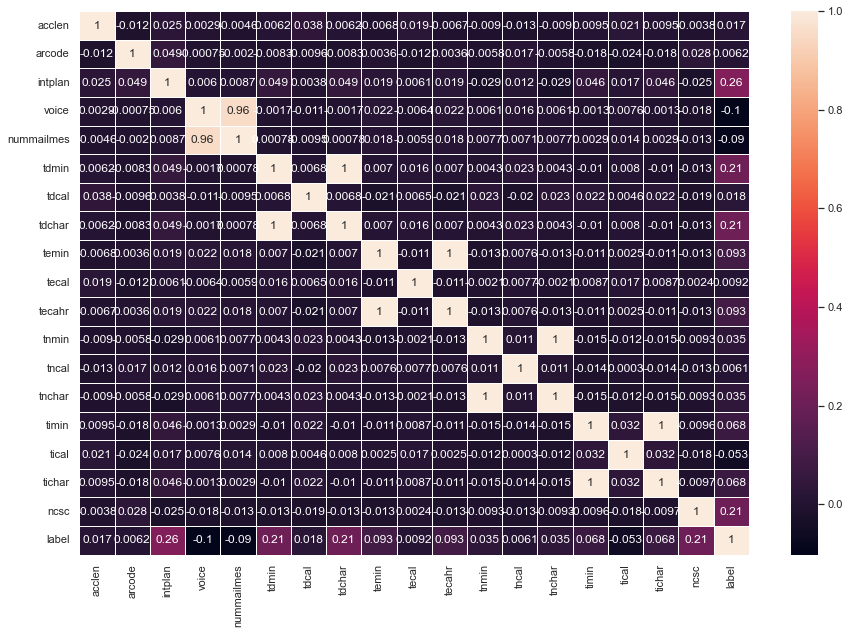

In [170]:
plt.figure(figsize = (15,10))
sns.heatmap(corr,annot=True,linewidth=.5)

There is almost no correlation between the attributes 


In [171]:
churned_df= df[df['label'] ==1]
not_churned_df= df[df['label'] ==0]

In [172]:
churned_df.head()

,st,acclen,arcode,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,label
10,IN,65,415,0,0,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4,1
15,NY,161,415,0,0,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4,1
21,CO,77,408,0,0,0,62.4,89,10.61,169.9,121,14.44,209.6,64,9.43,5.7,6,1.54,5,1
33,AZ,12,408,0,0,0,249.6,118,42.43,252.4,119,21.45,280.2,90,12.61,11.8,3,3.19,1,1
41,MD,135,408,1,1,41,173.1,85,29.43,203.9,107,17.33,122.2,78,5.50,14.6,15,3.94,0,1


In [173]:
not_churned_df.head()

,st,acclen,arcode,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,label
0,KS,128,415,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0
1,OH,107,415,0,1,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0
2,NJ,137,415,0,0,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0
3,OH,84,408,1,0,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0
4,OK,75,415,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0


In [174]:
#Creating 3 new columns for total charges,total calls and total minutes

df["t_charges"]=df[["tdchar","tecahr","tnchar"]].sum(axis=1)

df["t_call"]=df[["tdcal","tecal","tncal"]].sum(axis=1)

df["t_min"]=df[["tdmin","temin","tnmin"]].sum(axis=1)

In [175]:
df.sample(5)

,st,acclen,arcode,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,label,t_charges,t_call,t_min
913,GA,50,408,0,1,24,214.3,129,36.43,289.8,55,24.63,312.5,130,14.06,10.6,4,2.86,1,0,75.12,314,816.6
2965,WI,103,415,0,0,0,180.2,134,30.63,97.7,85,8.30,181.7,134,8.18,8.4,3,2.27,1,0,47.11,353,459.6
1746,DC,60,408,0,0,0,179.3,147,30.48,208.9,89,17.76,248.2,98,11.17,13.5,6,3.65,1,1,59.41,334,636.4
2969,NV,116,408,0,0,0,110.9,54,18.85,213.4,82,18.14,186.2,116,8.38,7.9,2,2.13,2,0,45.37,252,510.5
2578,GA,194,510,0,0,0,193.3,106,32.86,169.0,150,14.37,225.2,122,10.13,11.8,4,3.19,0,0,57.36,378,587.5


# Exploratory data analysis (EDA)

In [176]:
#Calculating Churn percentage w.r.t. states
State_data = pd.crosstab(df["st"],df["label"])
State_data['Percentage_Churn'] = State_data.apply(lambda x : x[1]*100/(x[0]+x[1]),axis = 1)
print(State_data)


label   0   1  Percentage_Churn
st                             
AK     49   3          5.769231
AL     72   8         10.000000
AR     44  11         20.000000
AZ     60   4          6.250000
CA     25   9         26.470588
CO     57   9         13.636364
CT     62  12         16.216216
DC     49   5          9.259259
DE     52   9         14.754098
FL     55   8         12.698413
GA     46   8         14.814815
HI     50   3          5.660377
IA     41   3          6.818182
ID     64   9         12.328767
IL     53   5          8.620690
IN     62   9         12.676056
KS     57  13         18.571429
KY     51   8         13.559322
LA     47   4          7.843137
MA     54  11         16.923077
MD     53  17         24.285714
ME     49  13         20.967742
MI     57  16         21.917808
MN     69  15         17.857143
MO     56   7         11.111111
MS     51  14         21.538462
MT     54  14         20.588235
NC     57  11         16.176471
ND     56   6          9.677419
NE     5

Text(0, 0.5, 'Number Of Customer')

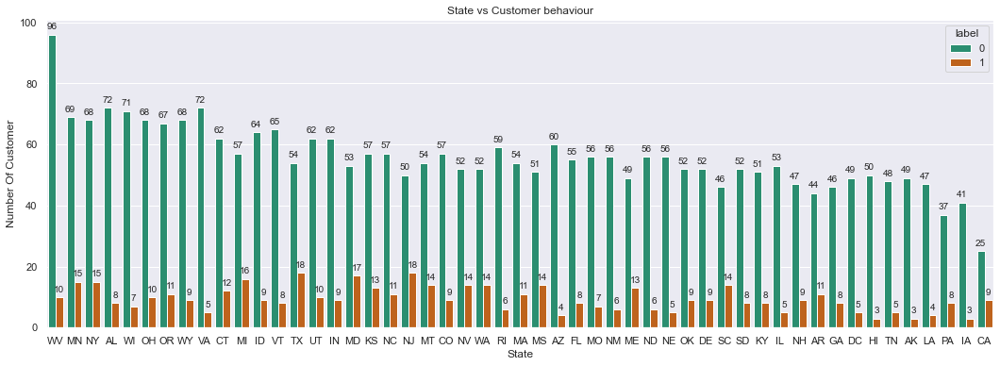

In [177]:
#How many customer had churned or not churned in each state
plt.figure(figsize=(18,6))
fig=sns.countplot(data=df,x="st",order = df['st'].value_counts().index,hue="label",palette='Dark2')
for bar in fig.patches:
    fig.annotate(format(bar.get_height()),
                    (bar.get_x() + bar.get_width() / 2,
                     bar.get_height()), ha='center', va='center',
                     size=10, xytext=(0, 8),
                     textcoords='offset points')
plt.title("State vs Customer behaviour")
plt.xlabel("State")
plt.ylabel("Number Of Customer")

Insights: From the above plot we can conclude that maximum customers churned from the state of 'TX' & 'NJ'. And most of the customers who did not churn are from state of 'WV', 'AL', 'WI' & 'VA'

In [178]:
#Calculating customer percentage over area
df["arcode"].value_counts()/df.shape[0]*100

415    49.654965
510    25.202520
408    25.142514
Name: arcode, dtype: float64

In [179]:
#Calculate Churn percentage w.r.t. Area code 

Area_code_data = pd.crosstab(df["arcode"],df["label"])
Area_code_data['Percentage_Churn'] = Area_code_data.apply(lambda x : x[1]*100/(x[0]+x[1]),axis = 1)
print(Area_code_data)


label      0    1  Percentage_Churn
arcode                             
408      716  122         14.558473
415     1419  236         14.259819
510      715  125         14.880952


Text(0, 0.5, 'Label')

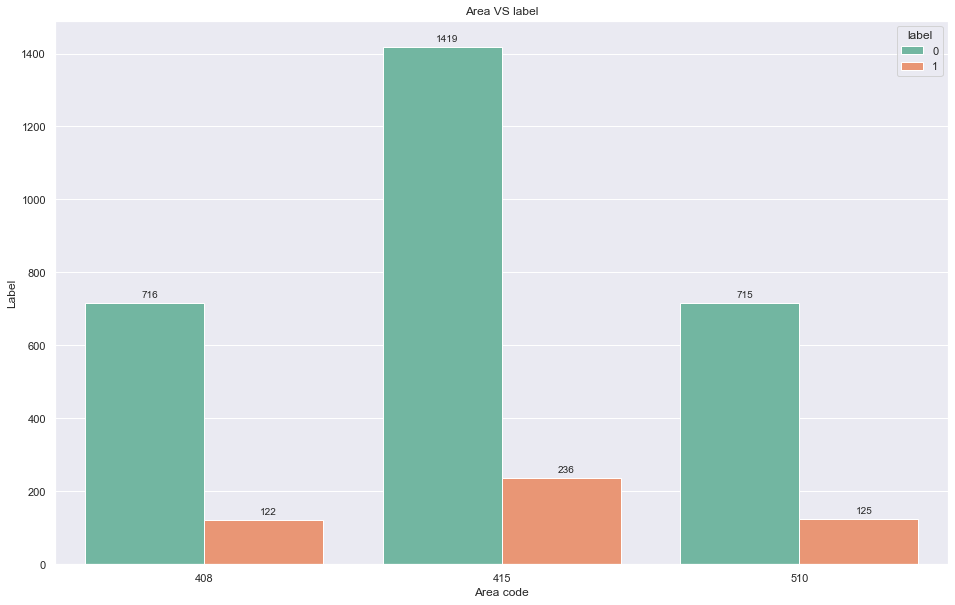

In [180]:
#Visualizing customer behaviour in particular areas

sns.set(style="darkgrid")
fig=plt.figure(figsize=(16,10))
fig=sns.countplot(data=df,x="arcode", hue="label",palette='Set2' )
for bar in fig.patches:
    fig.annotate(format(bar.get_height()),
                    (bar.get_x() + bar.get_width() / 2,
                     bar.get_height()), ha='center', va='center',
                     size=10, xytext=(5, 8),
                     textcoords='offset points')
plt.title("Area VS label")
plt.xlabel("Area code")
plt.ylabel('Label')

From the above plot it is evident that most of the churn and non churn customers belongs to area 415. And also we can see that the percentage of churn of each area code is around 14 percent, so we can say that the area code is not effecting the churn rate.

Text(0.5, 1.0, 'Customer Has  Churned')

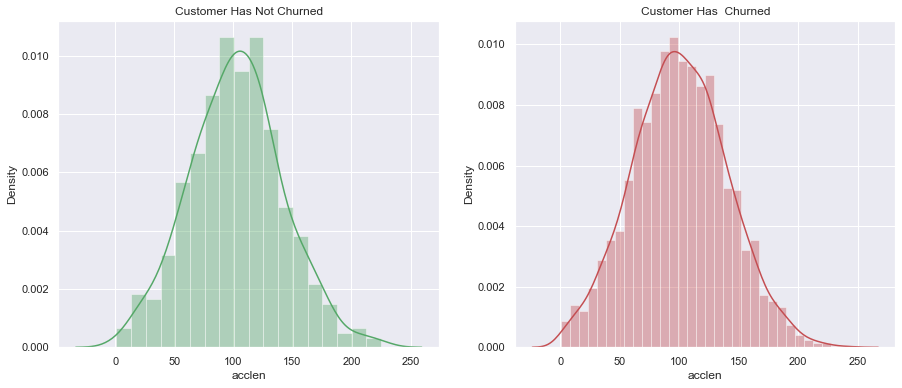

In [181]:
# Visualizing customer behaviour with account length
fig = plt.figure(figsize = (15, 6))
plt.subplot(121)
sns.distplot(df['acclen'][df['label']==1], color='g')
plt.title("Customer Has Not Churned")
plt.subplot(122)
sns.distplot(df['acclen'][df['label']==0], color='r')
plt.title("Customer Has  Churned")


This density plot proves that most of the churn and non-churn customer's account length is around 90 to 130, which means that account length is not effecting the churn rate.  

In [182]:
df['voice'].value_counts()/df.shape[0]*100

0    72.337234
1    27.662766
Name: voice, dtype: float64

In [183]:
#Calculate Churn percentage with Internet Plan  
voice_plan = pd.crosstab(df["voice"],df["label"])
voice_plan['Percentage Churn'] =voice_plan.apply(lambda x : x[1]*100/(x[0]+x[1]),axis = 1)
print(voice_plan)

label     0    1  Percentage Churn
voice                             
0      2008  403         16.715056
1       842   80          8.676790


In [184]:
#Visualizing the percentage of voice plan in churned and non churned data

import plotly.graph_objects as go
from plotly.subplots import make_subplots
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=not_churned_df["voice"].unique().tolist(), values=not_churned_df["voice"].value_counts()),1, 1)
fig.add_trace(go.Pie(labels=churned_df["voice"].unique().tolist(), values=churned_df["voice"].value_counts()),1, 2)
fig.update_traces(hole=.4,textinfo='percent+label')
fig.update_layout(
    title_text="Voice Plan vs Customer behaviour",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Not Churned', x=0.15, y=0.5, font_size=20, showarrow=False),
                 dict(text='Churned', x=0.83, y=0.5, font_size=20, showarrow=False)])

70 percent of people who have not churned had voice plan. And 83 percent of people did not had voice plan.
So we can conclude that, people who do not have voice plan are more likely to churn. 

In [185]:
df['intplan'].value_counts()/df.shape[0]*100

0    90.309031
1     9.690969
Name: intplan, dtype: float64

In [186]:
#Calculate Churn percentage with Internet Plan  
Internet_plan = pd.crosstab(df["intplan"],df["label"])
Internet_plan['Percentage Churn'] = Internet_plan.apply(lambda x : x[1]*100/(x[0]+x[1]),axis = 1)
print(Internet_plan)


label       0    1  Percentage Churn
intplan                             
0        2664  346         11.495017
1         186  137         42.414861


In [187]:
# #Visualizing the percentage of internet plan in churned and non churned data

# fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
# fig.add_trace(go.Pie(labels=not_churned_df["intplan"].unique().tolist(), values=not_churned_df["intplan"].value_counts()),1, 1)
# fig.add_trace(go.Pie(labels=churned_df["intplan"].unique().tolist(), values=churned_df["intplan"].value_counts()),1, 2)
# fig.update_traces(hole=.4,textinfo='percent+label')
# fig.update_layout(
#     title_text="Internet Plan vs Customer behaviour",
#     # Add annotations in the center of the donut pies.
#     annotations=[dict(text='Not Churned', x=0.15, y=0.5, font_size=20, showarrow=False),
#                  dict(text='Churned', x=0.83, y=0.5, font_size=20, showarrow=False)])


3010 customers does'nt have internet plan out of which only 11.4 % people has churned. 
323 customers have internet plan out of which  42.4 % people has churned. 

The people who have internet plans are churning in big numbers.



Text(0.5, 1.0, 'Customer Has  Churned')

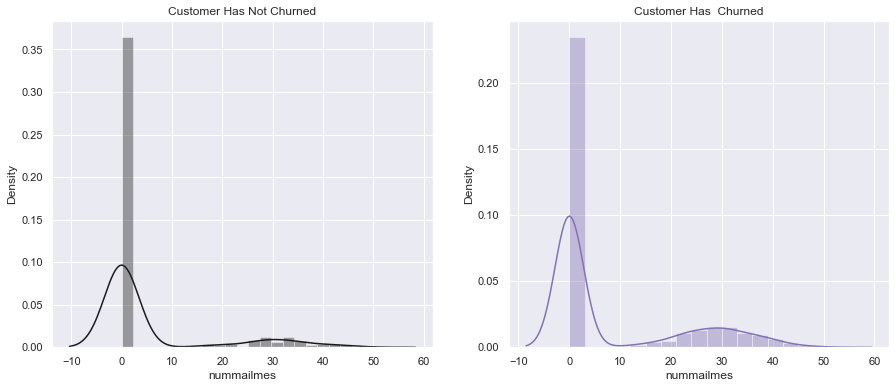

In [188]:
#Visualizing how mail is effecting the churn value 
fig = plt.figure(figsize = (15, 6))
plt.subplot(121)
sns.distplot(df['nummailmes'][df['label']==1], color='k')
plt.title("Customer Has Not Churned")
plt.subplot(122)
sns.distplot(df['nummailmes'][df['label']==0], color='m')
plt.title("Customer Has  Churned")


No. of emails is not effecting the churn rate.

Text(0.5, 1.0, 'Customer Has  Churned')

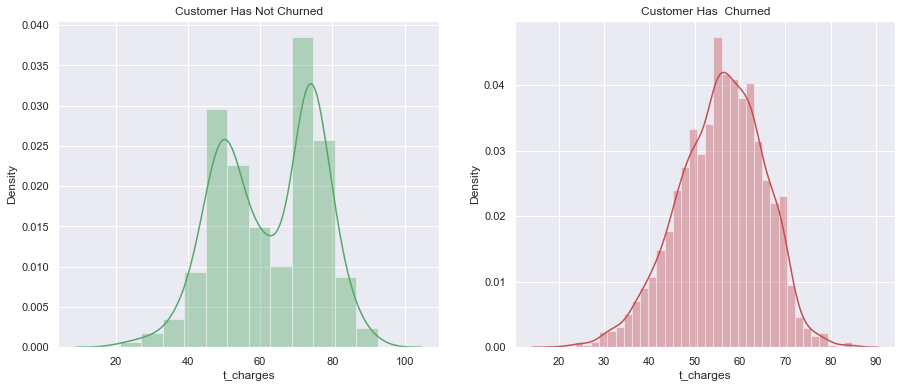

In [189]:
#Visualizing how the total Charges are effecting the churn of customers
fig = plt.figure(figsize = (15, 6))
plt.subplot(121)
sns.distplot(df['t_charges'][df['label']==1], color='g')
plt.title("Customer Has Not Churned")
plt.subplot(122)
sns.distplot(df['t_charges'][df['label']==0], color='r')
plt.title("Customer Has  Churned")

People with total charges around 50 to 70 have the tendency of churning as well as non churning. Therefore we can say that total_charges is not effecting the churning rate.

Text(0.5, 1.0, 'Customer Has  Churned')

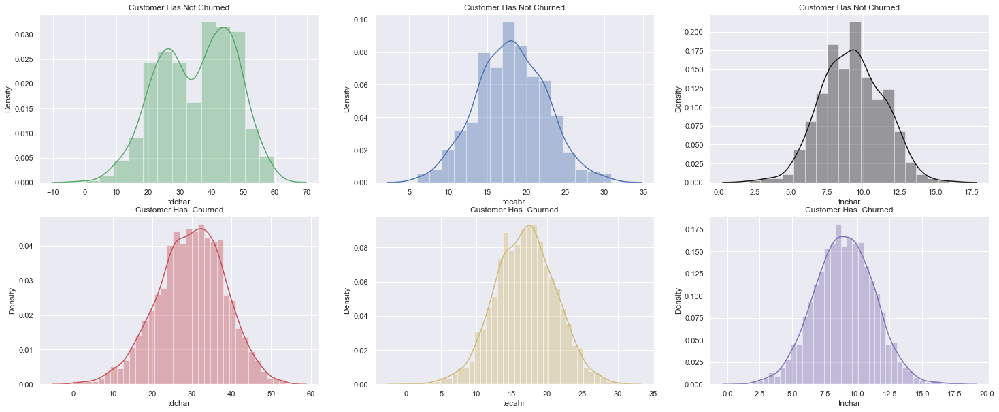

In [190]:
# Charges at Different times
fig = plt.figure(figsize = (25, 10))
plt.subplot(2,3,1)
sns.distplot(df['tdchar'][df['label']==1], color='g')
plt.title("Customer Has Not Churned")
plt.subplot(2,3,2)
sns.distplot(df['tecahr'][df['label']==1], color='b')
plt.title("Customer Has Not Churned")
plt.subplot(2,3,3)
sns.distplot(df['tnchar'][df['label']==1], color='k')
plt.title("Customer Has Not Churned")


plt.subplot(2,3,4)
sns.distplot(df['tdchar'][df['label']==0], color='r')
plt.title("Customer Has  Churned")
plt.subplot(2,3,5)
sns.distplot(df['tecahr'][df['label']==0], color='y')
plt.title("Customer Has  Churned")
plt.subplot(2,3,6)
sns.distplot(df['tnchar'][df['label']==0], color='m')
plt.title("Customer Has  Churned")

Text(0.5, 1.0, 'Customer Has  Churned')

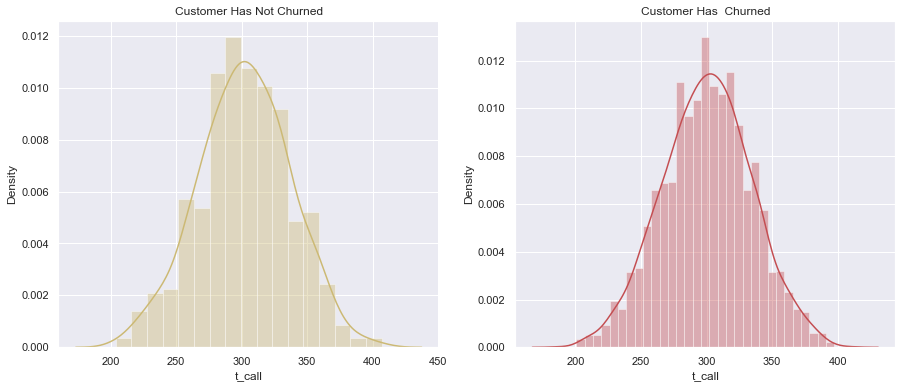

In [191]:
# How is total no of calls effecting the churn rate.
fig = plt.figure(figsize = (15, 6))
plt.subplot(121)
sns.distplot(df['t_call'][df['label']==1], color='y')
plt.title("Customer Has Not Churned")
plt.subplot(122)
sns.distplot(df['t_call'][df['label']==0], color='r')
plt.title("Customer Has  Churned")

Total call is not effecting the churn rate.

Text(0.5, 1.0, 'Customer Has  Churned')

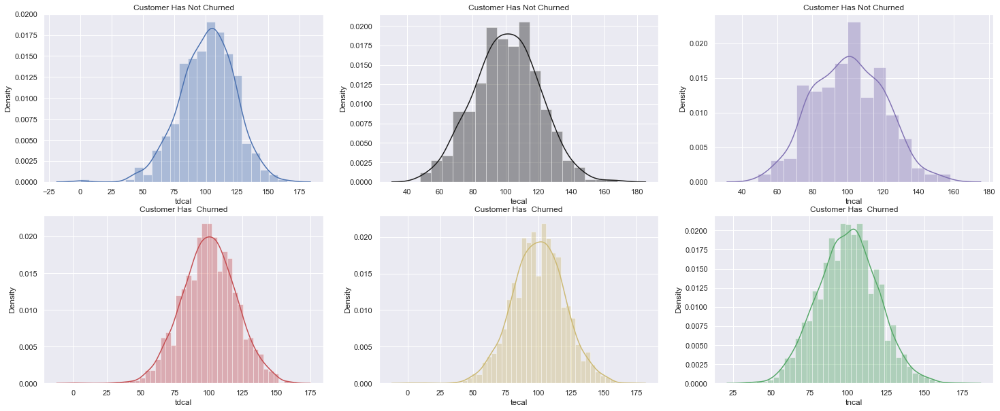

In [192]:
#Call at Different times
fig = plt.figure(figsize = (25, 10))
plt.subplot(2,3,1)
sns.distplot(df['tdcal'][df['label']==1], color='b')
plt.title("Customer Has Not Churned")
plt.subplot(2,3,2)
sns.distplot(df['tecal'][df['label']==1], color='k')
plt.title("Customer Has Not Churned")
plt.subplot(2,3,3)
sns.distplot(df['tncal'][df['label']==1], color='m')
plt.title("Customer Has Not Churned")


plt.subplot(2,3,4)
sns.distplot(df['tdcal'][df['label']==0], color='r')
plt.title("Customer Has  Churned")
plt.subplot(2,3,5)
sns.distplot(df['tecal'][df['label']==0], color='y')
plt.title("Customer Has  Churned")
plt.subplot(2,3,6)
sns.distplot(df['tncal'][df['label']==0], color='g')
plt.title("Customer Has  Churned")


Text(0.5, 1.0, 'Customer Has  Churned')

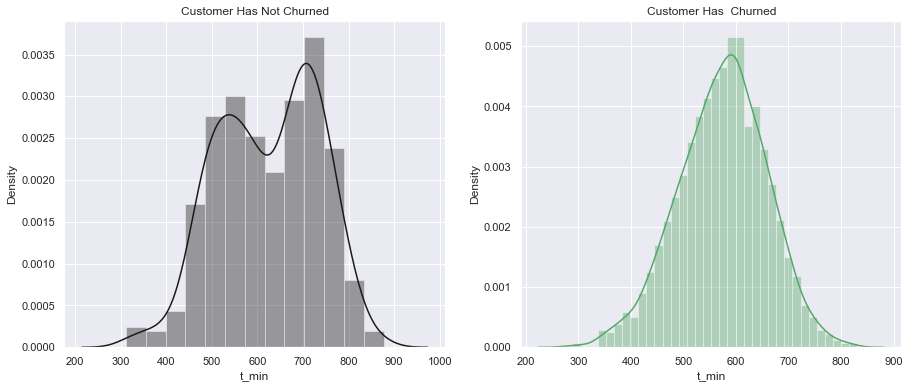

In [193]:
#How is total Minutes effecting the churn rate
fig = plt.figure(figsize = (15, 6))
plt.subplot(121)
sns.distplot(df['t_min'][df['label']==1], color='k')
plt.title("Customer Has Not Churned")
plt.subplot(122)
sns.distplot(df['t_min'][df['label']==0], color='g')
plt.title("Customer Has  Churned")

Text(0.5, 1.0, 'Customer Has  Churned')

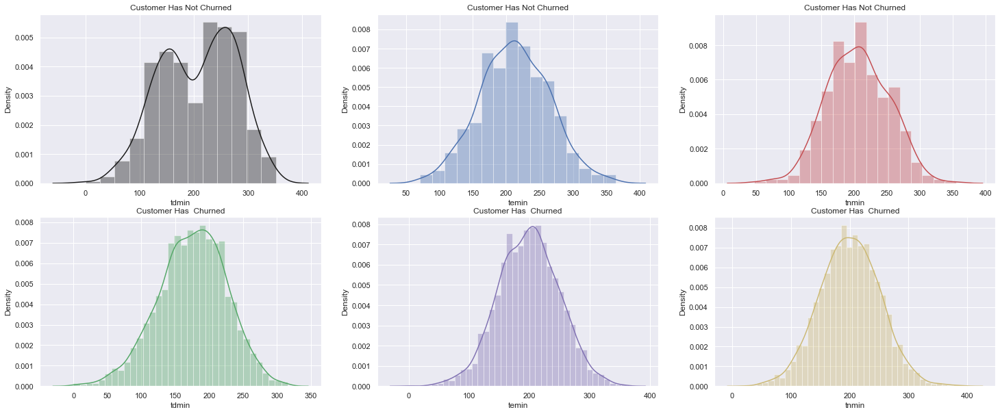

In [194]:
#Minutes at Different times
fig = plt.figure(figsize = (25, 10))
plt.subplot(2,3,1)
sns.distplot(df['tdmin'][df['label']==1], color='k')
plt.title("Customer Has Not Churned")
plt.subplot(2,3,2)
sns.distplot(df['temin'][df['label']==1], color='b')
plt.title("Customer Has Not Churned")
plt.subplot(2,3,3)
sns.distplot(df['tnmin'][df['label']==1], color='r')
plt.title("Customer Has Not Churned")


plt.subplot(2,3,4)
sns.distplot(df['tdmin'][df['label']==0], color='g')
plt.title("Customer Has  Churned")
plt.subplot(2,3,5)
sns.distplot(df['temin'][df['label']==0], color='m')
plt.title("Customer Has  Churned")
plt.subplot(2,3,6)
sns.distplot(df['tnmin'][df['label']==0], color='y')
plt.title("Customer Has  Churned")

In [195]:
#Printing the data of customer service calls 
df['ncsc'].value_counts()/df.shape[0]*100

1    35.433543
2    22.772277
0    20.912091
3    12.871287
4     4.980498
5     1.980198
6     0.660066
7     0.270027
9     0.060006
8     0.060006
Name: ncsc, dtype: float64

In [196]:
#Calculating the Customer service calls vs Churn percentage
Customer_service_calls_data = pd.crosstab(df['ncsc'],df["label"])
Customer_service_calls_data['Percentage_Churn'] = Customer_service_calls_data.apply(lambda x : x[1]*100/(x[0]+x[1]),axis = 1)
print(Customer_service_calls_data)

label     0    1  Percentage_Churn
ncsc                              
0       605   92         13.199426
1      1059  122         10.330229
2       672   87         11.462451
3       385   44         10.256410
4        90   76         45.783133
5        26   40         60.606061
6         8   14         63.636364
7         4    5         55.555556
8         1    1         50.000000
9         0    2        100.000000


<AxesSubplot:xlabel='ncsc', ylabel='count'>

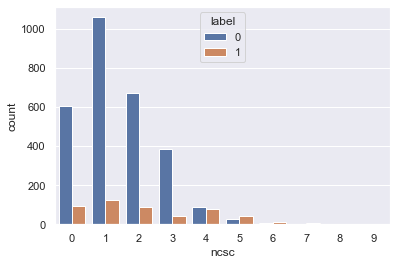

In [197]:
#Analysing using countplot
sns.countplot(x='ncsc',hue="label",data = df)

People making more than 4-5 customer service calls has a high percentage of churning

In [198]:
# CHECKING FOR CLASS IMBALANCE
df['label'].value_counts()/df.shape[0]*100

0    85.508551
1    14.491449
Name: label, dtype: float64

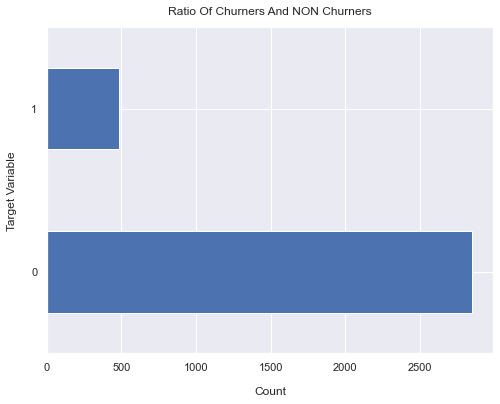

In [200]:
df['label'].value_counts().plot(kind='barh', figsize=(8, 6))
plt.xlabel("Count", labelpad=14)
plt.ylabel("Target Variable", labelpad=14)
plt.title("Ratio Of Churners And NON Churners", y=1.02);


The data is imbalanced.

In [201]:
# Applying 'ONE HOT ENCODING' to state and areacode

df=pd.get_dummies(df,columns=["st","arcode"],drop_first=True)

In [202]:
df.head()

,acclen,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,label,t_charges,t_call,t_min,st_AL,st_AR,st_AZ,st_CA,st_CO,st_CT,st_DC,st_DE,st_FL,st_GA,st_HI,st_IA,st_ID,st_IL,st_IN,st_KS,st_KY,st_LA,st_MA,st_MD,st_ME,st_MI,st_MN,st_MO,st_MS,st_MT,st_NC,st_ND,st_NE,st_NH,st_NJ,st_NM,st_NV,st_NY,st_OH,st_OK,st_OR,st_PA,st_RI,st_SC,st_SD,st_TN,st_TX,st_UT,st_VA,st_VT,st_WA,st_WI,st_WV,st_WY,arcode_415,arcode_510
0,128,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0,72.86,300,707.2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,107,0,1,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,0,55.54,329,611.5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,137,0,0,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,0,59.00,328,527.2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
3,84,1,0,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0,65.02,248,558.2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,75,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0,49.36,356,501.9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [203]:
eda_df=df.copy()

In [49]:
#separting label output data
y = df[('label')]

In [50]:
X = df.loc[:,df.columns != 'label']
X.head()

,acclen,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,t_charges,t_call,t_min,st_AL,st_AR,st_AZ,st_CA,st_CO,st_CT,st_DC,st_DE,st_FL,st_GA,st_HI,st_IA,st_ID,st_IL,st_IN,st_KS,st_KY,st_LA,st_MA,st_MD,st_ME,st_MI,st_MN,st_MO,st_MS,st_MT,st_NC,st_ND,st_NE,st_NH,st_NJ,st_NM,st_NV,st_NY,st_OH,st_OK,st_OR,st_PA,st_RI,st_SC,st_SD,st_TN,st_TX,st_UT,st_VA,st_VT,st_WA,st_WI,st_WV,st_WY,arcode_415,arcode_510
0,128,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,72.86,300,707.2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,107,0,1,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,55.54,329,611.5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2,137,0,0,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,59.00,328,527.2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
3,84,1,0,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,65.02,248,558.2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,75,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,49.36,356,501.9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


In [51]:
#numcols=X.columns
#print(numcols)
print(X)

      acclen  intplan  voice  nummailmes  tdmin  tdcal  tdchar  temin  tecal  \
0        128        0      1          25  265.1    110   45.07  197.4     99   
1        107        0      1          26  161.6    123   27.47  195.5    103   
2        137        0      0           0  243.4    114   41.38  121.2    110   
3         84        1      0           0  299.4     71   50.90   61.9     88   
4         75        1      0           0  166.7    113   28.34  148.3    122   
5        118        1      0           0  223.4     98   37.98  220.6    101   
6        121        0      1          24  218.2     88   37.09  348.5    108   
7        147        1      0           0  157.0     79   26.69  103.1     94   
8        117        0      0           0  184.5     97   31.37  351.6     80   
9        141        1      1          37  258.6     84   43.96  222.0    111   
10        65        0      0           0  129.1    137   21.95  228.5     83   
11        74        0      0           0

In [52]:
X.shape

(3333, 72)

In [53]:
X.columns

Index(['acclen', 'intplan', 'voice', 'nummailmes', 'tdmin', 'tdcal', 'tdchar',
       'temin', 'tecal', 'tecahr', 'tnmin', 'tncal', 'tnchar', 'timin',
       'tical', 'tichar', 'ncsc', 't_charges', 't_call', 't_min', 'st_AL',
       'st_AR', 'st_AZ', 'st_CA', 'st_CO', 'st_CT', 'st_DC', 'st_DE', 'st_FL',
       'st_GA', 'st_HI', 'st_IA', 'st_ID', 'st_IL', 'st_IN', 'st_KS', 'st_KY',
       'st_LA', 'st_MA', 'st_MD', 'st_ME', 'st_MI', 'st_MN', 'st_MO', 'st_MS',
       'st_MT', 'st_NC', 'st_ND', 'st_NE', 'st_NH', 'st_NJ', 'st_NM', 'st_NV',
       'st_NY', 'st_OH', 'st_OK', 'st_OR', 'st_PA', 'st_RI', 'st_SC', 'st_SD',
       'st_TN', 'st_TX', 'st_UT', 'st_VA', 'st_VT', 'st_WA', 'st_WI', 'st_WV',
       'st_WY', 'arcode_415', 'arcode_510'],
      dtype='object')

In [54]:
# scaler=preprocessing.StandardScaler()
# #scaler.fit(X)
# X=scaler.fit_transform(X)
# y=scaler.fit_transform(y)

In [55]:
scaler = preprocessing.StandardScaler()
X = scaler.fit_transform(X)
print(X)

[[ 0.67648946 -0.32758048  1.6170861  ... -0.15378117  1.00692466
  -0.5804683 ]
 [ 0.14906505 -0.32758048  1.6170861  ... -0.15378117  1.00692466
  -0.5804683 ]
 [ 0.9025285  -0.32758048 -0.61839626 ... -0.15378117  1.00692466
  -0.5804683 ]
 ...
 [-1.83505538 -0.32758048 -0.61839626 ... -0.15378117 -0.99312296
   1.72274698]
 [ 2.08295458  3.05268496 -0.61839626 ... -0.15378117 -0.99312296
   1.72274698]
 [-0.67974475 -0.32758048  1.6170861  ... -0.15378117  1.00692466
  -0.5804683 ]]


In [56]:
df = pd.DataFrame(X, columns = ['acclen', 'intplan', 'voice', 'nummailmes', 'tdmin', 'tdcal', 'tdchar',
       'temin', 'tecal', 'tecahr', 'tnmin', 'tncal', 'tnchar', 'timin',
       'tical', 'tichar', 'ncsc', 't_charges', 't_call', 't_min', 'st_AL',
       'st_AR', 'st_AZ', 'st_CA', 'st_CO', 'st_CT', 'st_DC', 'st_DE', 'st_FL',
       'st_GA', 'st_HI', 'st_IA', 'st_ID', 'st_IL', 'st_IN', 'st_KS', 'st_KY',
       'st_LA', 'st_MA', 'st_MD', 'st_ME', 'st_MI', 'st_MN', 'st_MO', 'st_MS',
       'st_MT', 'st_NC', 'st_ND', 'st_NE', 'st_NH', 'st_NJ', 'st_NM', 'st_NV',
       'st_NY', 'st_OH', 'st_OK', 'st_OR', 'st_PA', 'st_RI', 'st_SC', 'st_SD',
       'st_TN', 'st_TX', 'st_UT', 'st_VA', 'st_VT', 'st_WA', 'st_WI', 'st_WV',
       'st_WY', 'arcode_415', 'arcode_510'])

In [57]:
X = df
X

,acclen,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,t_charges,t_call,t_min,st_AL,st_AR,st_AZ,st_CA,st_CO,st_CT,st_DC,st_DE,st_FL,st_GA,st_HI,st_IA,st_ID,st_IL,st_IN,st_KS,st_KY,st_LA,st_MA,st_MD,st_ME,st_MI,st_MN,st_MO,st_MS,st_MT,st_NC,st_ND,st_NE,st_NH,st_NJ,st_NM,st_NV,st_NY,st_OH,st_OK,st_OR,st_PA,st_RI,st_SC,st_SD,st_TN,st_TX,st_UT,st_VA,st_VT,st_WA,st_WI,st_WV,st_WY,arcode_415,arcode_510
0,0.676489,-0.327580,1.617086,1.234883,1.566767,0.476643,1.567036,-0.070610,-0.055940,-0.070427,0.866743,-0.465494,0.866029,-0.085008,-0.601195,-0.085690,-0.427932,1.542481,-0.019161,1.395935,-0.156821,-0.129532,-0.139921,-0.101519,-0.142134,-0.150686,-0.128329,-0.136539,-0.138802,-0.128329,-0.127116,-0.115663,-0.149642,-0.133079,-0.147532,6.827466,-0.134241,-0.124657,-0.141031,-0.146467,-0.137675,-0.149642,-0.160792,-0.138802,-0.141031,-0.144315,-0.144315,-0.137675,-0.136539,-0.130724,-0.144315,-0.137675,-0.142134,-0.159808,-0.154800,-0.136539,-0.154800,-0.116988,-0.141031,-0.135395,-0.135395,-0.127116,-0.148590,-0.148590,-0.153781,-0.149642,-0.142134,-0.154800,-0.181240,-0.153781,1.006925,-0.580468
1,0.149065,-0.327580,1.617086,1.307948,-0.333738,1.124503,-0.334013,-0.108080,0.144867,-0.107549,1.058571,0.147825,1.059390,1.240482,-0.601195,1.241169,-0.427932,-0.109207,0.825751,0.332080,-0.156821,-0.129532,-0.139921,-0.101519,-0.142134,-0.150686,-0.128329,-0.136539,-0.138802,-0.128329,-0.127116,-0.115663,-0.149642,-0.133079,-0.147532,-0.146467,-0.134241,-0.124657,-0.141031,-0.146467,-0.137675,-0.149642,-0.160792,-0.138802,-0.141031,-0.144315,-0.144315,-0.137675,-0.136539,-0.130724,-0.144315,-0.137675,-0.142134,-0.159808,6.459936,-0.136539,-0.154800,-0.116988,-0.141031,-0.135395,-0.135395,-0.127116,-0.148590,-0.148590,-0.153781,-0.149642,-0.142134,-0.154800,-0.181240,-0.153781,1.006925,-0.580468
2,0.902529,-0.327580,-0.618396,-0.591760,1.168304,0.675985,1.168464,-1.573383,0.496279,-1.573900,-0.756869,0.198935,-0.755571,0.703121,0.211534,0.697156,-1.188218,0.220749,0.796617,-0.605047,-0.156821,-0.129532,-0.139921,-0.101519,-0.142134,-0.150686,-0.128329,-0.136539,-0.138802,-0.128329,-0.127116,-0.115663,-0.149642,-0.133079,-0.147532,-0.146467,-0.134241,-0.124657,-0.141031,-0.146467,-0.137675,-0.149642,-0.160792,-0.138802,-0.141031,-0.144315,-0.144315,-0.137675,-0.136539,-0.130724,6.929264,-0.137675,-0.142134,-0.159808,-0.154800,-0.136539,-0.154800,-0.116988,-0.141031,-0.135395,-0.135395,-0.127116,-0.148590,-0.148590,-0.153781,-0.149642,-0.142134,-0.154800,-0.181240,-0.153781,1.006925,-0.580468
3,-0.428590,3.052685,-0.618396,-0.591760,2.196596,-1.466936,2.196759,-2.742865,-0.608159,-2.743268,-0.078551,-0.567714,-0.078806,-1.303026,1.024263,-1.306401,0.332354,0.794835,-1.534177,-0.260433,-0.156821,-0.129532,-0.139921,-0.101519,-0.142134,-0.150686,-0.128329,-0.136539,-0.138802,-0.128329,-0.127116,-0.115663,-0.149642,-0.133079,-0.147532,-0.146467,-0.134241,-0.124657,-0.141031,-0.146467,-0.137675,-0.149642,-0.160792,-0.138802,-0.141031,-0.144315,-0.144315,-0.137675,-0.136539,-0.130724,-0.144315,-0.137675,-0.142134,-0.159808,6.459936,-0.136539,-0.154800,-0.116988,-0.141031,-0.135395,-0.135395,-0.127116,-0.148590,-0.148590,-0.153781,-0.149642,-0.142134,-0.154800,-0.181240,-0.153781,-0.993123,-0.580468
4,-0.654629,3.052685,-0.618396,-0.591760,-0.240090,0.626149,-0.240041,-1.038932,1.098699,-1.037939,-0.276311,1.067803,-0.276562,-0.049184,-0.601195,-0.045885,1.092641,-0.698551,1.612394,-0.886296,-0.156821,-0.129532,-0.139921,-0.101519,-0.142134,-0.150686,-0.128329,-0.136539,-0.138802,-0.128329,-0.127116,-0.115663,-0.149642,-0.133079,-0.147532,-0.146467,-0.134241,-0.124657,-0.141031,-0.146467,-0.137675,-0.149642,-0.160792,-0.138802,-0.141031,-0.144315,-0.144315,-0.137675,-0.136539,-0.130724,-0.144315,-0.137675,-0.142134,-0.159808,-0.154800,7.323889,-0.154800,-0.116988,-0.141031,-0.135395,-0.135395,-0.127116,-0.148590,-0.148590,-0.153781,-0.149642,-0.142134,-0.154800,-0.181240,-0.153781,1.00

##### BALANCING THE DATASET USING SMOTE

In [58]:
print(f'Original dataset shape : {Counter(y)}')

Original dataset shape : Counter({0: 2850, 1: 483})


In [59]:
smote = SMOTE(random_state=42)
x_res, y_res = smote.fit_resample(X, y)

In [60]:
print(f'Resampled dataset shape {Counter(y_res)}')

Resampled dataset shape Counter({0: 2850, 1: 2850})


##### SPLITTING THE DATA INTO TRAIN(80%) AND TEST DATA(20%)

In [61]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x_res, y_res, test_size =.2,random_state=42) 

In [62]:
x_train[:3]

,acclen,intplan,voice,nummailmes,tdmin,tdcal,tdchar,temin,tecal,tecahr,tnmin,tncal,tnchar,timin,tical,tichar,ncsc,t_charges,t_call,t_min,st_AL,st_AR,st_AZ,st_CA,st_CO,st_CT,st_DC,st_DE,st_FL,st_GA,st_HI,st_IA,st_ID,st_IL,st_IN,st_KS,st_KY,st_LA,st_MA,st_MD,st_ME,st_MI,st_MN,st_MO,st_MS,st_MT,st_NC,st_ND,st_NE,st_NH,st_NJ,st_NM,st_NV,st_NY,st_OH,st_OK,st_OR,st_PA,st_RI,st_SC,st_SD,st_TN,st_TX,st_UT,st_VA,st_VT,st_WA,st_WI,st_WV,st_WY,arcode_415,arcode_510
43,1.480184,-0.32758,-0.618396,-0.591760,-1.725605,-1.167924,-1.725235,-0.703668,0.496279,-0.703834,-0.442430,-0.414384,-0.443556,-0.371601,-0.194831,-0.377599,1.092641,-1.908708,-0.630994,-1.690024,-0.156821,-0.129532,-0.139921,-0.101519,-0.142134,-0.150686,-0.128329,-0.136539,-0.138802,-0.128329,-0.127116,-0.115663,6.682629,-0.133079,-0.147532,-0.146467,-0.134241,-0.124657,-0.141031,-0.146467,-0.137675,-0.149642,-0.160792,-0.138802,-0.141031,-0.144315,-0.144315,-0.137675,-0.136539,-0.130724,-0.144315,-0.137675,-0.142134,-0.159808,-0.1548,-0.136539,-0.1548,-0.116988,-0.141031,-0.135395,-0.135395,-0.127116,-0.14859,-0.14859,-0.153781,-0.149642,-0.142134,-0.1548,-0.18124,-0.153781,1.006925,-0.580468
1891,1.128568,-0.32758,-0.618396,-0.591760,0.470534,0.028125,0.470693,-1.303200,-1.160378,-1.302439,2.168006,-0.874374,2.166824,0.022464,-1.007560,0.020458,1.092641,0.350443,-1.155423,0.768961,-0.156821,-0.129532,-0.139921,-0.101519,-0.142134,-0.150686,-0.128329,-0.136539,-0.138802,-0.128329,-0.127116,-0.115663,-0.149642,-0.133079,-0.147532,-0.146467,-0.134241,-0.124657,-0.141031,-0.146467,-0.137675,-0.149642,-0.160792,-0.138802,-0.141031,-0.144315,-0.144315,-0.137675,-0.136539,-0.130724,-0.144315,-0.137675,-0.142134,-0.159808,-0.1548,-0.136539,-0.1548,-0.116988,-0.141031,-0.135395,-0.135395,-0.127116,-0.14859,-0.14859,6.502747,-0.149642,-0.142134,-0.1548,-0.18124,-0.153781,1.006925,-0.580468
3195,-0.604398,-0.32758,1.617086,1.527146,0.575199,-0.569899,0.575466,0.444120,-0.156344,0.444652,-1.037689,0.301154,-1.036824,-0.192480,1.836992,-0.191839,0.332354,0.465832,-0.252240,0.015258,-0.156821,-0.129532,-0.139921,-0.101519,-0.142134,-0.150686,-0.128329,-0.136539,-0.138802,-0.128329,-0.127116,-0.115663,6.682629,-0.133079,-0.147532,-0.146467,-0.134241,-0.124657,-0.141031,-0.146467,-0.137675,-0.149642,-0.160792,-0.138802,-0.141031,-0.144315,-0.144315,-0.137675,-0.136539,-0.130724,-0.144315,-0.137675,-0.142134,-0.159808,-0.1548,-0.136539,-0.1548,-0.116988,-0.141031,-0.135395,-0.135395,-0.127116,-0.14859,-0.14859,-0.153781,-0.149642,-0.142134,-0.1548,-0.18124,-0.153781,-0.993123,1.722747


In [63]:
x_train_orig=x_train.copy()
x_test_orig=x_test.copy()

##### CHECKING FOR THE BEST MODEL

##### IMPLEMENTING  ALL MODELS TO CHECK THE BEST ONE

In [64]:
def printmetrics(actual,predicted):
    print('AUC : ',np.round(metrics.roc_auc_score(actual,predicted),4))
    print('Accuracy :',np.round(metrics.accuracy_score(actual,predicted),4))
    print('Precision : ',np.round(metrics.precision_score(actual,predicted),4))
    print('Recall : ',np.round(metrics.recall_score(actual,predicted),4))
    print('F1 : ',np.round(metrics.f1_score(actual,predicted),4))
    

# RANDOM FOREST

In [65]:
# Without Features Selections:

In [66]:
model=ensemble.RandomForestClassifier(random_state= 42)
model.fit(x_train,y_train)
predtrain=model.predict(x_train)
predtest=model.predict(x_test)

In [67]:
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain)
print("\n")
print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest)

TRAINING METRICS
----------------
AUC :  1.0
Accuracy : 1.0
Precision :  1.0
Recall :  1.0
F1 :  1.0


TEST METRICS
----------------
AUC :  0.9728
Accuracy : 0.9728
Precision :  0.9712
Recall :  0.973
F1 :  0.9721


The model is overfit.

In [68]:
## Hyper parameter Tuning using GridSearchCV 

hyper_dist = {
   'max_depth':[5,6,7,8,9,10],
    'min_samples_split':[75,80,90,100], 
    'min_samples_leaf':[35,40,45,50],
    'n_estimators': [10,20, 40, 60, 70, 80, 90, 100]
}

In [69]:
from sklearn.model_selection import GridSearchCV
grid = GridSearchCV(model,param_grid = hyper_dist, cv=5,scoring='recall',n_jobs=-1)

In [70]:
grid.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [5, 6, 7, 8, 9, 10],
                         'min_samples_leaf': [35, 40, 45, 50],
                         'min_samples_split': [75, 80, 90, 100],
                         'n_estimators': [10, 20, 40, 60, 70, 80, 90, 100]},
             scoring='recall')

In [71]:
grid.best_params_

{'max_depth': 10,
 'min_samples_leaf': 35,
 'min_samples_split': 100,
 'n_estimators': 100}

In [72]:
model_rf=ensemble.RandomForestClassifier(n_estimators=200, criterion='gini', random_state = 42,max_depth=10, min_samples_leaf=35)

Features Selections: 
Applying RFE for feature selection .

In [73]:


from sklearn.feature_selection import RFE


select = RFE(estimator=model_rf, step=1, n_features_to_select = 7) 
select.fit(x_train,y_train)


print("X_train.shape: {}".format(x_train.shape))

X_train.shape: (4560, 72)


In [74]:
print(select)

RFE(estimator=RandomForestClassifier(max_depth=10, min_samples_leaf=35,
                                     n_estimators=200, random_state=42),
    n_features_to_select=7)


In [75]:
x_train_selected = select.transform(x_train)
x_test_selected=  select.transform(x_test)

In [76]:
print(); print(np.where(select.support_ == True)[0])



[ 1  2  4  6 16 17 70]


In [77]:
df_selected_fea_train = x_train.iloc[:, [1,  2,  4,  6, 16, 17, 70]] 
df_selected_fea_train


,intplan,voice,tdmin,tdchar,ncsc,t_charges,arcode_415
43,-0.327580,-0.618396,-1.725605,-1.725235,1.092641,-1.908708,1.006925
1891,-0.327580,-0.618396,0.470534,0.470693,1.092641,0.350443,1.006925
3195,-0.327580,1.617086,0.575199,0.575466,0.332354,0.465832,-0.993123
3442,-0.327580,-0.618396,-0.871042,-0.871075,1.376777,-0.336710,0.380632
4991,-0.327580,0.346293,0.507556,0.507543,0.436460,1.189658,0.143834
1071,-0.327580,-0.618396,0.468698,0.468532,-0.427932,0.640346,-0.993123
718,-0.327580,-0.618396,0.046363,0.046197,-0.427932,-0.283722,-0.993123
5106,0.133942,-0.618396,-0.856030,-0.855732,1.852927,-1.119560,-0.993123
5488,-0.327580,-0.618396,1.839901,1.839856,-0.184620,1.941501,1.006925
670,-0.327580,1.617086,1.596147,1.596200,-0.427932,1.715088,-0.993123


In [78]:
df_selected_fea_test = x_test.iloc[:, [1,  2,  4,  6, 16, 17, 70]] 

In [79]:
clf = model_rf.fit(x_train_selected,y_train)

In [80]:

predtrain_RF=clf.predict(x_train_selected)
predtest_RF=clf.predict(x_test_selected)

In [81]:
#By selected features 
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain_RF)
print("\n")
print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest_RF)

TRAINING METRICS
----------------
AUC :  0.9021
Accuracy : 0.902
Precision :  0.9129
Recall :  0.8902
F1 :  0.9014


TEST METRICS
----------------
AUC :  0.9143
Accuracy : 0.914
Precision :  0.903
Recall :  0.9225
F1 :  0.9127


# DECISION TREE

In [82]:


model=tree.DecisionTreeClassifier(random_state=42)
model=model.fit(x_train,y_train)

In [83]:
def printmetrics(actual,predicted):
    print('AUC : ',np.round(metrics.roc_auc_score(actual,predicted),4))
    print('Accuracy :',np.round(metrics.accuracy_score(actual,predicted),4))
    print('Precision : ',np.round(metrics.precision_score(actual,predicted),4))
    print('Recall : ',np.round(metrics.recall_score(actual,predicted),4))
    print('F1 : ',np.round(metrics.f1_score(actual,predicted),4))

In [84]:

predtrain=model.predict(x_train)
predtest=model.predict(x_test)

In [85]:
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain)
print("\n")
print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest)

TRAINING METRICS
----------------
AUC :  1.0
Accuracy : 1.0
Precision :  1.0
Recall :  1.0
F1 :  1.0


TEST METRICS
----------------
AUC :  0.9356
Accuracy : 0.9351
Precision :  0.9168
Recall :  0.9532
F1 :  0.9346


In [86]:
## Hyper parameter tuning using GridSearchCV

hyper_dist = {
    'max_depth':[5,6,7,8,9,10],
    'min_samples_split':[75,80,90,100], 
    'min_samples_leaf':[35,40,45,50]
}

In [87]:
from sklearn.model_selection import GridSearchCV
grid = GridSearchCV(model,param_grid = hyper_dist, cv = 5, n_jobs=-1, scoring='recall')

In [88]:
grid.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [5, 6, 7, 8, 9, 10],
                         'min_samples_leaf': [35, 40, 45, 50],
                         'min_samples_split': [75, 80, 90, 100]},
             scoring='recall')

In [89]:
grid.best_estimator_

DecisionTreeClassifier(max_depth=9, min_samples_leaf=35, min_samples_split=75,
                       random_state=42)

In [90]:
grid.best_params_

{'max_depth': 9, 'min_samples_leaf': 35, 'min_samples_split': 75}

In [91]:
model_DT=DecisionTreeClassifier( criterion='gini', random_state = 42,max_depth=10, min_samples_leaf=50, max_leaf_nodes= None) 

In [92]:

from sklearn.feature_selection import RFE

select = RFE(estimator=model_DT, step=1, n_features_to_select = 7)
select.fit(x_train,y_train)


print("X_train.shape: {}".format(x_train.shape))

X_train.shape: (4560, 72)


In [93]:
print(select)

RFE(estimator=DecisionTreeClassifier(max_depth=10, min_samples_leaf=50,
                                     random_state=42),
    n_features_to_select=7)


In [94]:
x_train_selected = select.transform(x_train)
x_test_selected=  select.transform(x_test)

In [95]:

select.support_

array([False,  True,  True, False, False, False, False, False, False,
       False, False, False, False, False,  True,  True,  True,  True,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False,  True, False])

In [96]:
print(); print(np.where(select.support_ == True)[0])


[ 1  2 14 15 16 17 70]


In [97]:
clf = model_DT.fit(x_train_selected,y_train)

In [98]:
predtrain_Dec=clf.predict(x_train_selected)
predtest_Dec=clf.predict(x_test_selected)

In [99]:
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain_Dec)
print('    ')
print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest_Dec)

TRAINING METRICS
----------------
AUC :  0.9169
Accuracy : 0.9164
Precision :  0.9785
Recall :  0.8527
F1 :  0.9113
    
TEST METRICS
----------------
AUC :  0.9305
Accuracy : 0.9316
Precision :  0.9686
Recall :  0.8883
F1 :  0.9267


[Text(0.8393368320610687, 0.9545454545454546, 'X[5] <= 1.298\ngini = 0.5\nsamples = 4560\nvalue = [2265, 2295]'),
 Text(0.7244751908396947, 0.8636363636363636, 'X[0] <= -0.323\ngini = 0.479\nsamples = 3611\nvalue = [2178, 1433]'),
 Text(0.6168893129770993, 0.7727272727272727, 'X[4] <= 1.1\ngini = 0.394\nsamples = 2792\nvalue = [2038, 754]'),
 Text(0.4933206106870229, 0.6818181818181818, 'X[5] <= 0.232\ngini = 0.248\nsamples = 2286\nvalue = [1955, 331]'),
 Text(0.3530534351145038, 0.5909090909090909, 'X[1] <= 1.602\ngini = 0.165\nsamples = 1415\nvalue = [1287, 128]'),
 Text(0.23282442748091603, 0.5, 'X[4] <= -0.401\ngini = 0.197\nsamples = 1040\nvalue = [925, 115]'),
 Text(0.12213740458015267, 0.4090909090909091, 'X[2] <= -0.136\ngini = 0.136\nsamples = 598\nvalue = [554, 44]'),
 Text(0.061068702290076333, 0.3181818181818182, 'X[6] <= 0.877\ngini = 0.084\nsamples = 343\nvalue = [328, 15]'),
 Text(0.030534351145038167, 0.22727272727272727, 'X[2] <= -0.644\ngini = 0.13\nsamples = 172\nval

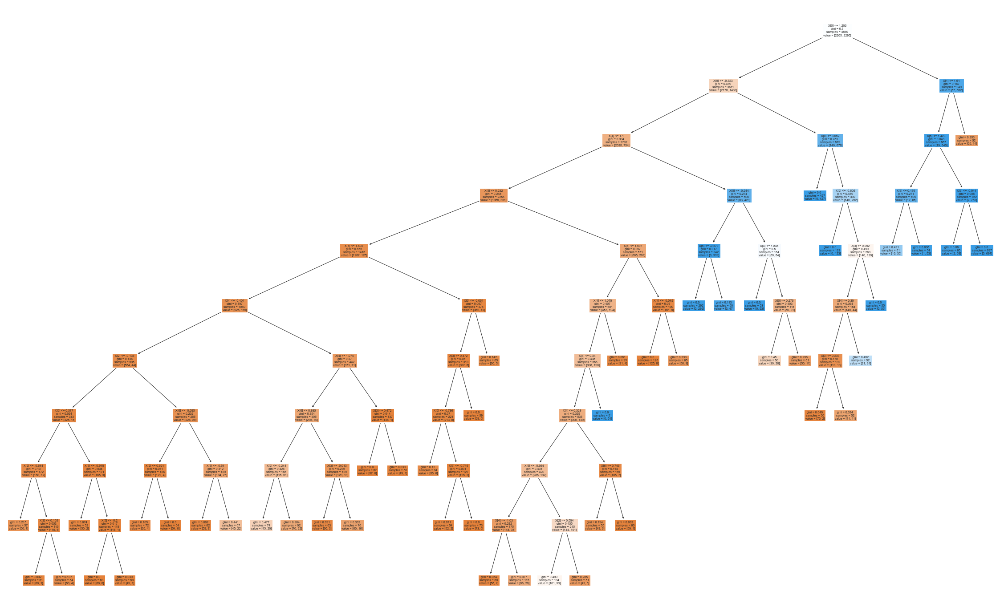

In [100]:
plt.figure(figsize=(40,25))

tree.plot_tree(clf, filled=True)

# Logistic Regression

In [101]:
model_lr=linear_model.LogisticRegression()
model.fit(x_train,y_train)
predtrain=model.predict(x_train)
predtest=model.predict(x_test)

In [102]:
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain)
print('    ')
print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest)

TRAINING METRICS
----------------
AUC :  1.0
Accuracy : 1.0
Precision :  1.0
Recall :  1.0
F1 :  1.0
    
TEST METRICS
----------------
AUC :  0.9356
Accuracy : 0.9351
Precision :  0.9168
Recall :  0.9532
F1 :  0.9346


In [103]:
# Grid Search
param_grid = {'C': np.logspace(-4, 4, 50),
             'penalty':['l1', 'l2']}
clf = GridSearchCV(LogisticRegression(random_state=1), param_grid, cv=5, verbose=0, n_jobs=-1)
best_model = clf.fit(x_train,y_train)
print(best_model.best_estimator_)
print("The mean accuracy of the model is:",best_model.score(x_train,y_train))

LogisticRegression(C=1526.4179671752302, random_state=1)
The mean accuracy of the model is: 0.7964912280701755


In [104]:

Lr=linear_model.LogisticRegression( C=4714.8663634573895, random_state= 42 )

In [105]:
from sklearn.feature_selection import RFE

select = RFE(Lr, n_features_to_select=7, step=1)
select.fit(x_train,y_train)


print("X_train.shape: {}".format(x_train.shape))

X_train.shape: (4560, 72)


In [106]:
print(select)

RFE(estimator=LogisticRegression(C=4714.8663634573895, random_state=42),
    n_features_to_select=7)


In [107]:
print(); print(np.where(select.support_ == True)[0])


[ 1  2  3 14 15 16 17]


In [108]:
select.fit(x_train,y_train)

RFE(estimator=LogisticRegression(C=4714.8663634573895, random_state=42),
    n_features_to_select=7)

In [109]:
x_train_selected = select.transform(x_train)
x_test_selected=  select.transform(x_test)

In [110]:
# model_lr=linear_model.LogisticRegression( C=4714.8663634573895, random_state= 42 )

In [111]:
clf = model_lr.fit(x_train_selected,y_train)

In [112]:

predtrain=clf.predict(x_train_selected)
predtest=clf.predict(x_test_selected)

In [113]:
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain)
print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest)

TRAINING METRICS
----------------
AUC :  0.7845
Accuracy : 0.7846
Precision :  0.7771
Recall :  0.8022
F1 :  0.7895
TEST METRICS
----------------
AUC :  0.7937
Accuracy : 0.793
Precision :  0.7699
Recall :  0.8198
F1 :  0.7941


# KNN

In [114]:
from sklearn import neighbors

knn=KNeighborsClassifier()

In [115]:
model=knn.fit(x_train, y_train)

In [116]:
predtrain=model.predict(x_train)
predtest=model.predict(x_test)

In [117]:
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain)
print('    ')
print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest)

TRAINING METRICS
----------------
AUC :  0.8976
Accuracy : 0.8982
Precision :  0.8347
Recall :  0.9948
F1 :  0.9078
    
TEST METRICS
----------------
AUC :  0.8623
Accuracy : 0.8588
Precision :  0.7767
Recall :  0.9964
F1 :  0.8729


In [118]:
#GridSearchCV 

In [119]:
k_range = list(range(1, 31))

In [120]:
param_grid = dict(n_neighbors=k_range)

In [121]:
grid = GridSearchCV(knn, param_grid, cv=10, return_train_score=False,verbose=1, n_jobs =-1)

In [122]:
grid=grid.fit(x_train, y_train)

Fitting 10 folds for each of 30 candidates, totalling 300 fits


In [123]:
grid.best_estimator_

KNeighborsClassifier(n_neighbors=2)

In [124]:
grid.best_params_

{'n_neighbors': 2}

In [125]:
model_knn=neighbors.KNeighborsClassifier(n_neighbors=2)  # applying GridSEarchCV's value

In [126]:
clf=model_knn.fit(df_selected_fea_train, y_train)

In [127]:
predtrain=clf.predict(df_selected_fea_train)
predtest=clf.predict(df_selected_fea_test)

In [128]:
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain)
print('    ')
print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest)

TRAINING METRICS
----------------
AUC :  0.951
Accuracy : 0.9507
Precision :  1.0
Recall :  0.902
F1 :  0.9485
    
TEST METRICS
----------------
AUC :  0.8921
Accuracy : 0.8939
Precision :  0.9502
Recall :  0.8252
F1 :  0.8833


# NAIVE BAYES

In [129]:
from sklearn.naive_bayes import GaussianNB
gnb = GaussianNB()
gnb.fit(x_train,y_train)

GaussianNB()

In [130]:
predtrain = gnb.predict(x_train)
predtest = gnb.predict(x_test)

In [131]:
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain)

print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest)

TRAINING METRICS
----------------
AUC :  0.6539
Accuracy : 0.6546
Precision :  0.6306
Recall :  0.7573
F1 :  0.6882
TEST METRICS
----------------
AUC :  0.6207
Accuracy : 0.6175
Precision :  0.5849
Recall :  0.7387
F1 :  0.6529


In [132]:
model=gnb.fit(df_selected_fea_train, y_train)

In [133]:
predtrain=model.predict(df_selected_fea_train)
predtest=model.predict(df_selected_fea_test)

In [134]:
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain)
print('    ')
print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest)

TRAINING METRICS
----------------
AUC :  0.7722
Accuracy : 0.7721
Precision :  0.7821
Recall :  0.7586
F1 :  0.7702
    
TEST METRICS
----------------
AUC :  0.7958
Accuracy : 0.7956
Precision :  0.7825
Recall :  0.8036
F1 :  0.7929


# Best Model For This Dataset.
# Final Model

We are choosing Random Forest as our best model for the given dataset as Recall and AUC metrics are giving best ouput. 

In [135]:
print('TRAINING METRICS')
print('----------------')
printmetrics(y_train,predtrain_RF)
print('    ')
print('TEST METRICS')
print('----------------')
printmetrics(y_test,predtest_RF)

TRAINING METRICS
----------------
AUC :  0.9021
Accuracy : 0.902
Precision :  0.9129
Recall :  0.8902
F1 :  0.9014
    
TEST METRICS
----------------
AUC :  0.9143
Accuracy : 0.914
Precision :  0.903
Recall :  0.9225
F1 :  0.9127


In [136]:
print(classification_report(y_test,predtest_RF, labels=[0,1]))

              precision    recall  f1-score   support

           0       0.92      0.91      0.92       585
           1       0.90      0.92      0.91       555

    accuracy                           0.91      1140
   macro avg       0.91      0.91      0.91      1140
weighted avg       0.91      0.91      0.91      1140



In [137]:
cm = confusion_matrix(y_test, predtest_RF)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[530  55]
 [ 43 512]]


# Eda

From the above feature selection we are selecting 7 features they are :
we are doing EDA with these 7 features

In [205]:
neda_df=eda_df[['intplan','voice','tdmin','tdchar','ncsc','t_charges','arcode_415']]

In [206]:
neda_df["label"]=y_res

In [207]:
neda_df.head()

,intplan,voice,tdmin,tdchar,ncsc,t_charges,arcode_415,label
0,0,1,265.1,45.07,1,72.86,1,0
1,0,1,161.6,27.47,1,55.54,1,0
2,0,0,243.4,41.38,0,59.00,1,0
3,1,0,299.4,50.90,2,65.02,0,0
4,1,0,166.7,28.34,3,49.36,1,0


In [ ]:
sns.pairplot(neda_df)

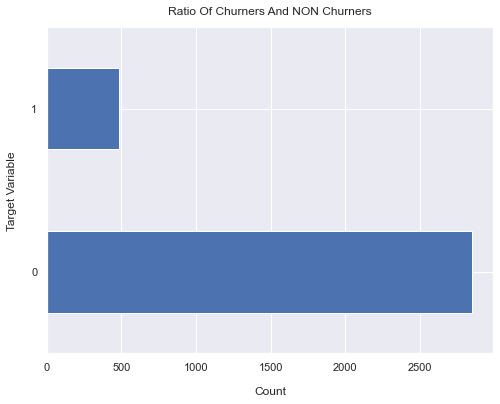

In [225]:
neda_df['label'].value_counts().plot(kind='barh', figsize=(8, 6))
plt.xlabel("Count", labelpad=14)
plt.ylabel("Target Variable", labelpad=14)
plt.title("Ratio Of Churners And NON Churners", y=1.02);

<AxesSubplot:xlabel='intplan', ylabel='count'>

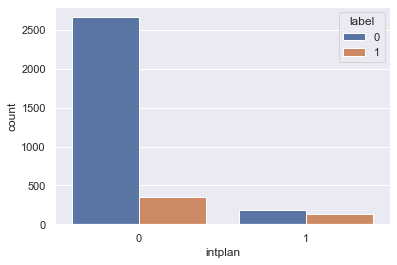

In [208]:
sns.countplot(data=neda_df,x="intplan",hue="label")

<AxesSubplot:xlabel='voice', ylabel='count'>

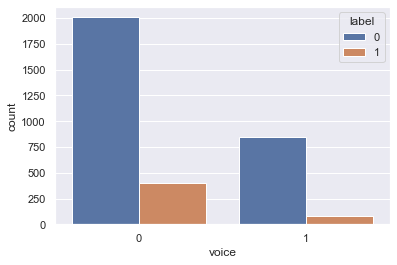

In [210]:
sns.countplot(data=neda_df,x="voice",hue="label")

<AxesSubplot:xlabel='ncsc', ylabel='count'>

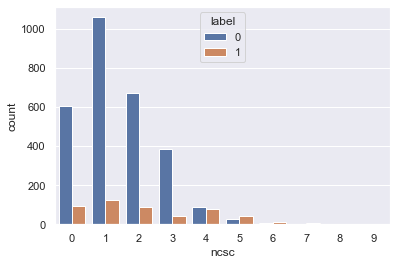

In [216]:

sns.countplot(data=neda_df,x="ncsc",hue="label")

<AxesSubplot:xlabel='arcode_415', ylabel='count'>

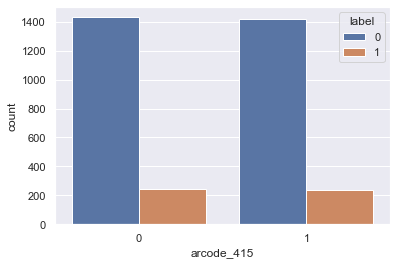

In [217]:

sns.countplot(data=neda_df,x="arcode_415",hue="label")

<AxesSubplot:xlabel='t_charges', ylabel='Density'>

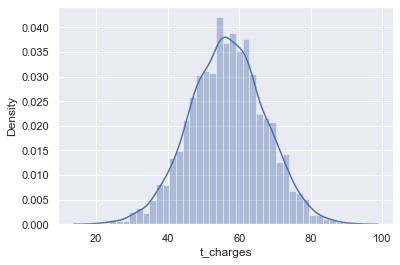

In [218]:
sns.distplot(neda_df['t_charges'])

In [220]:
neda_df_notchurn=neda_df[neda_df["label"]==0]
neda_df_churn=neda_df[neda_df["label"]==1]

Text(0.5, 1.0, 'Customer Has  Churned')

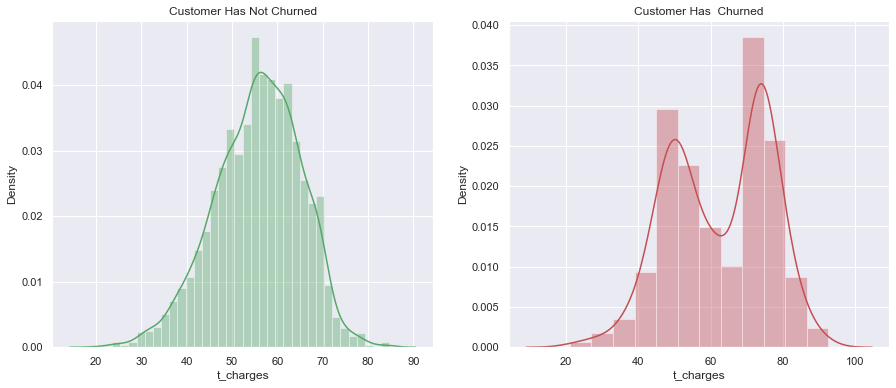

In [222]:
#Visualizing how the total Charges are effecting the churn of customers
fig = plt.figure(figsize = (15, 6))
plt.subplot(121)
sns.distplot(neda_df['t_charges'][neda_df['label']==0], color='g')
plt.title("Customer Has Not Churned")
plt.subplot(122)
sns.distplot(neda_df['t_charges'][neda_df['label']==1], color='r')
plt.title("Customer Has  Churned")

Text(0.5, 1.0, 'Customer Has  Churned')

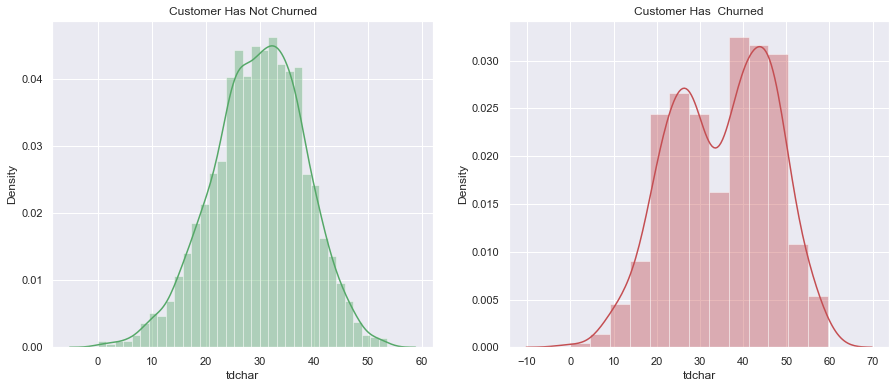

In [223]:
#Visualizing how the total day Charges are effecting the churn of customers
fig = plt.figure(figsize = (15, 6))
plt.subplot(121)
sns.distplot(neda_df['tdchar'][neda_df['label']==0], color='g')
plt.title("Customer Has Not Churned")
plt.subplot(122)
sns.distplot(neda_df['tdchar'][neda_df['label']==1], color='r')
plt.title("Customer Has  Churned")

Text(0.5, 1.0, 'Customer Has  Churned')

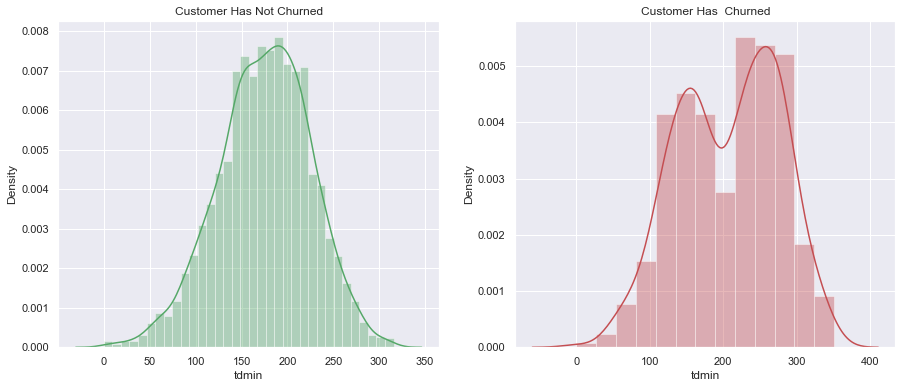

In [224]:
#Visualizing how the total day Minutes are effecting the churn of customers
fig = plt.figure(figsize = (15, 6))
plt.subplot(121)
sns.distplot(neda_df['tdmin'][neda_df['label']==0], color='g')
plt.title("Customer Has Not Churned")
plt.subplot(122)
sns.distplot(neda_df['tdmin'][neda_df['label']==1], color='r')
plt.title("Customer Has  Churned")